# Predictive Analytics - House Price Prediction 



#### Import Library yang dibutuhkan
Import library  yang diperlukan untuk analisis dan pemodelan data.- Import pustaka dan modul yang diperlukan untuk analisis dan pemodelan data.

In [119]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

#### Membaca dataset

- Mendefinisikan path file dataset (`output.csv`) yang akan digunakan.
- Membaca dataset menggunakan `pd.read_csv()` dan menyimpannya dalam variabel `df_house`.
- Menampilkan beberapa baris pertama dari dataset untuk melihat struktur data.

In [ ]:
path_to_file = './data/output.csv'
df_house = pd.read_csv(path_to_file)

df_house

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,sqft_above,sqft_basement,yr_built,yr_renovated,street,city,statezip,country
0,2014-05-02 00:00:00,3.130000e+05,3.0,1.50,1340,7912,1.5,0,0,3,1340,0,1955,2005,18810 Densmore Ave N,Shoreline,WA 98133,USA
1,2014-05-02 00:00:00,2.384000e+06,5.0,2.50,3650,9050,2.0,0,4,5,3370,280,1921,0,709 W Blaine St,Seattle,WA 98119,USA
2,2014-05-02 00:00:00,3.420000e+05,3.0,2.00,1930,11947,1.0,0,0,4,1930,0,1966,0,26206-26214 143rd Ave SE,Kent,WA 98042,USA
3,2014-05-02 00:00:00,4.200000e+05,3.0,2.25,2000,8030,1.0,0,0,4,1000,1000,1963,0,857 170th Pl NE,Bellevue,WA 98008,USA
4,2014-05-02 00:00:00,5.500000e+05,4.0,2.50,1940,10500,1.0,0,0,4,1140,800,1976,1992,9105 170th Ave NE,Redmond,WA 98052,USA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4595,2014-07-09 00:00:00,3.081667e+05,3.0,1.75,1510,6360,1.0,0,0,4,1510,0,1954,1979,501 N 143rd St,Seattle,WA 98133,USA
4596,2014-07-09 00:00:00,5.343333e+05,3.0,2.50,1460,7573,2.0,0,0,3,1460,0,1983,2009,14855 SE 10th Pl,Bellevue,WA 98007,USA
4597,2014-07-09 00:00:00,4.169042e+05,3.0,2.50,3010,7014,2.0,0,0,3,3010,0,2009,0,759 Ilwaco Pl NE,Renton,WA 98059,USA
4598,2014-07-10 00:00:00,2.034000e+05,4.0,2.00,2090,6630,1.0,0,0,3,1070,1020,1974,0,5148 S Creston St,Seattle,WA 98178,USA


### Menampilkan informasi tentang dataset

In [121]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4600 entries, 0 to 4599
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           4600 non-null   object 
 1   price          4600 non-null   float64
 2   bedrooms       4600 non-null   float64
 3   bathrooms      4600 non-null   float64
 4   sqft_living    4600 non-null   int64  
 5   sqft_lot       4600 non-null   int64  
 6   floors         4600 non-null   float64
 7   waterfront     4600 non-null   int64  
 8   view           4600 non-null   int64  
 9   condition      4600 non-null   int64  
 10  sqft_above     4600 non-null   int64  
 11  sqft_basement  4600 non-null   int64  
 12  yr_built       4600 non-null   int64  
 13  yr_renovated   4600 non-null   int64  
 14  street         4600 non-null   object 
 15  city           4600 non-null   object 
 16  statezip       4600 non-null   object 
 17  country        4600 non-null   object 
dtypes: float

### Memperbaiki type data

Mengonversi kolom `date` pada dataset menjadi tipe data `datetime` menggunakan `pd.to_datetime()` untuk mempermudah analisis berbasis waktu.


In [122]:
df_house['date'] = pd.to_datetime(df_house['date'])

In [123]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4600 entries, 0 to 4599
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           4600 non-null   datetime64[ns]
 1   price          4600 non-null   float64       
 2   bedrooms       4600 non-null   float64       
 3   bathrooms      4600 non-null   float64       
 4   sqft_living    4600 non-null   int64         
 5   sqft_lot       4600 non-null   int64         
 6   floors         4600 non-null   float64       
 7   waterfront     4600 non-null   int64         
 8   view           4600 non-null   int64         
 9   condition      4600 non-null   int64         
 10  sqft_above     4600 non-null   int64         
 11  sqft_basement  4600 non-null   int64         
 12  yr_built       4600 non-null   int64         
 13  yr_renovated   4600 non-null   int64         
 14  street         4600 non-null   object        
 15  city           4600 n

### Melihat Statistik data

Menampilkan statistik deskriptif dataset, seperti rata-rata (mean), standar deviasi (std), nilai minimum, kuartil, dan nilai maksimum untuk setiap kolom numerik.

In [124]:
df_house.describe()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,sqft_above,sqft_basement,yr_built,yr_renovated
count,4600,4.600000e+03,4600.000000,4600.000000,4600.000000,4.600000e+03,4600.000000,4600.000000,4600.000000,4600.000000,4600.000000,4600.000000,4600.000000,4600.000000
mean,2014-06-07 03:14:42.782608640,5.519630e+05,3.400870,2.160815,2139.103478,1.485252e+04,1.512065,0.007174,0.240652,3.451739,1827.265435,312.081522,1970.786304,808.608261
min,2014-05-02 00:00:00,0.000000e+00,0.000000,0.000000,370.000000,6.380000e+02,1.000000,0.000000,0.000000,1.000000,370.000000,0.000000,1900.000000,0.000000
25%,2014-05-21 00:00:00,3.228750e+05,3.000000,1.750000,1460.000000,5.000750e+03,1.000000,0.000000,0.000000,3.000000,1190.000000,0.000000,1951.000000,0.000000
50%,2014-06-09 00:00:00,4.609435e+05,3.000000,2.250000,1980.000000,7.683000e+03,1.500000,0.000000,0.000000,3.000000,1590.000000,0.000000,1976.000000,0.000000
75%,2014-06-24 00:00:00,6.549625e+05,4.000000,2.500000,2620.000000,1.100125e+04,2.000000,0.000000,0.000000,4.000000,2300.000000,610.000000,1997.000000,1999.000000
max,2014-07-10 00:00:00,2.659000e+07,9.000000,8.000000,13540.000000,1.074218e+06,3.500000,1.000000,4.000000,5.000000,9410.000000,4820.000000,2014.000000,2014.000000
std,NaN,5.638347e+05,0.908848,0.783781,963.159990,3.588444e+04,0.538288,0.084404,0.778405,0.677230,862.168977,464.137228,29.731848,979.414536


### Memeriksa data yang kemungkinan tidak valid

Menampilkan baris dalam dataset di mana nilai `price` sama dengan 0. Ini berguna untuk mengidentifikasi entri yang tidak valid atau tidak relevan. 


In [125]:
df_house.loc[(df_house['price']==0)]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,sqft_above,sqft_basement,yr_built,yr_renovated,street,city,statezip,country
4354,2014-05-05,0.0,3.0,1.75,1490,10125,1.0,0,0,4,1490,0,1962,0,3911 S 328th St,Federal Way,WA 98001,USA
4356,2014-05-05,0.0,4.0,2.75,2600,5390,1.0,0,0,4,1300,1300,1960,2001,2120 31st Ave W,Seattle,WA 98199,USA
4357,2014-05-05,0.0,6.0,2.75,3200,9200,1.0,0,2,4,1600,1600,1953,1983,12271 Marine View Dr SW,Burien,WA 98146,USA
4358,2014-05-06,0.0,5.0,3.50,3480,36615,2.0,0,0,4,2490,990,1983,0,21809 SE 38th Pl,Issaquah,WA 98075,USA
4361,2014-05-07,0.0,5.0,1.50,1500,7112,1.0,0,0,5,760,740,1920,0,14901-14999 12th Ave SW,Burien,WA 98166,USA
4362,2014-05-07,0.0,4.0,4.00,3680,18804,2.0,0,0,3,3680,0,1990,2009,1223-1237 244th Ave NE,Sammamish,WA 98074,USA
4374,2014-05-09,0.0,2.0,2.50,2200,188200,1.0,0,3,3,2200,0,2007,0,39612 254th Ave SE,Enumclaw,WA 98022,USA
4376,2014-05-09,0.0,4.0,2.25,2170,10500,1.0,0,2,4,1270,900,1960,2001,216 SW 183rd St,Normandy Park,WA 98166,USA
4382,2014-05-12,0.0,5.0,4.50,4630,6324,2.0,0,0,3,3210,1420,2006,0,6925 Oakmont Ave SE,Snoqualmie,WA 98065,USA
4383,2014-05-13,0.0,5.0,4.00,4430,9000,2.0,0,0,3,4430,0,2013,1923,9235 NE 5th St,Bellevue,WA 98004,USA


### Menghapus data yang tidak valid berdasarkan statistik

- Menghapus baris dari dataset di mana nilai `price` kurang dari atau sama dengan 0.
- Menampilkan ukuran dataset setelah penghapusan untuk memastikan jumlah baris telah berkurang.

In [126]:
df_house = df_house[df_house['price'] > 0]

In [127]:
df_house.shape

(4551, 18)

### Mengidentifikasi outliers

- Mengidentifikasi kolom numerik dalam dataset.
- Menghitung kuartil pertama (Q1), kuartil ketiga (Q3), dan rentang interkuartil (IQR) untuk setiap kolom numerik.
- Menghapus outlier berdasarkan aturan IQR (nilai di luar rentang [Q1 - 1.5*IQR, Q3 + 1.5*IQR]).
- Menampilkan ukuran dataset setelah outlier dihapus untuk memastikan perubahan.

In [128]:
numeric_columns = df_house.select_dtypes(include=['float64', 'int64']).columns

Q1 = df_house[numeric_columns].quantile(0.25)
Q3 = df_house[numeric_columns].quantile(0.75)
IQR = Q3 - Q1

# Hapus outliers
df_house = df_house[~((df_house[numeric_columns] < (Q1 - 1.5 * IQR)) | 
                       (df_house[numeric_columns] > (Q3 + 1.5 * IQR))).any(axis=1)]

# Cek ukuran dataset setelah menghapus outliers
df_house.shape

(3422, 18)

In [129]:
df_house.describe()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,sqft_above,sqft_basement,yr_built,yr_renovated
count,3422,3.422000e+03,3422.000000,3422.000000,3422.000000,3422.000000,3422.000000,3422.0,3422.0,3422.000000,3422.000000,3422.000000,3422.000000,3422.000000
mean,2014-06-07 03:25:46.464056064,4.573935e+05,3.285213,2.019141,1884.497078,7190.212449,1.497078,0.0,0.0,3.444477,1642.614261,242.297779,1970.921683,804.772940
min,2014-05-02 00:00:00,8.300000e+04,2.000000,0.750000,580.000000,681.000000,1.000000,0.0,0.0,2.000000,580.000000,0.000000,1900.000000,0.000000
25%,2014-05-21 00:00:00,3.060000e+05,3.000000,1.500000,1370.000000,4712.250000,1.000000,0.0,0.0,3.000000,1140.000000,0.000000,1951.000000,0.000000
50%,2014-06-09 00:00:00,4.250000e+05,3.000000,2.000000,1820.000000,7191.000000,1.500000,0.0,0.0,3.000000,1460.000000,0.000000,1975.000000,0.000000
75%,2014-06-24 00:00:00,5.736250e+05,4.000000,2.500000,2310.000000,9246.250000,2.000000,0.0,0.0,4.000000,2030.000000,500.000000,1998.000000,1999.000000
max,2014-07-10 00:00:00,1.150000e+06,5.000000,3.500000,4140.000000,19901.000000,3.500000,0.0,0.0,5.000000,3960.000000,1500.000000,2014.000000,2014.000000
std,NaN,1.953596e+05,0.777052,0.653532,667.498404,3588.208710,0.545763,0.0,0.0,0.660169,663.744170,370.679988,30.148105,978.601748


### Visualisasi Dataset 
- Memisahkan kolom dataset menjadi fitur kategorikal dan numerikal.
- Menyiapkan grid untuk membuat beberapa plot dalam satu figure.
- Melakukan iterasi pada setiap fitur kategorikal dan membuat bar chart yang menampilkan distribusi nilai di masing-masing kolom.
- Jika suatu fitur tidak ada, subplot dibiarkan kosong.

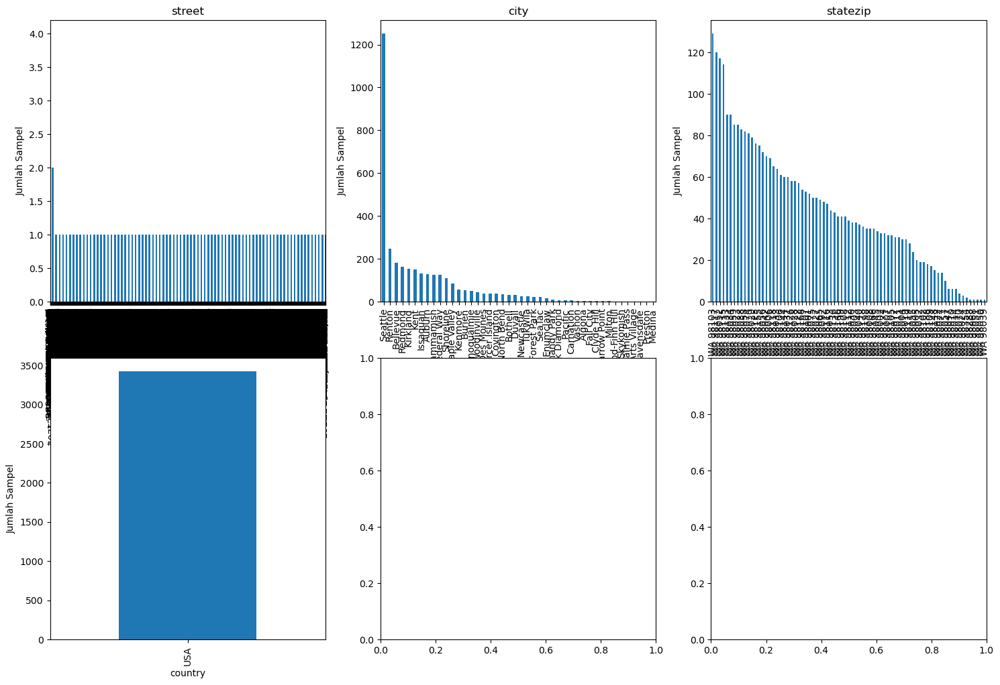

In [130]:
categorical_features = df_house.select_dtypes(include=['object', 'category']).columns.tolist()
numerical_features = df_house.select_dtypes(include=['number']).columns.tolist()

# Setup untuk grid plot
num_features = len(categorical_features)
rows = (num_features + 2) // 3  
fig, axes = plt.subplots(rows, 3, figsize=(18, rows * 6))  
axes = axes.flatten()  

# Loop melalui setiap feature dan buat bar chart
for i, feature in enumerate(categorical_features):
    if feature in df_house.columns:
        count = df_house[feature].value_counts()
        percent = 100 * df_house[feature].value_counts(normalize=True)
        df = pd.DataFrame({'Jumlah Sampel': count, 'Persentase': percent.round(1)})

        # Plot bar chart pada subplot yang sesuai
        count.plot(kind='bar', title=feature, ax=axes[i])
        axes[i].set_ylabel('Jumlah Sampel')
    else:
        # Kosongkan subplot jika feature tidak ada
        axes[i].axis('off')

#### Membuat fungsi visualisasi data berdasarkan price

- Fungsi untuk membuat bar chart berdasarkan kolom kategorikal tertentu dalam dataset.
- Memvalidasi apakah kolom yang diberikan ada di dataset, lalu menghitung distribusi jumlah sampel dan persentasenya.
- Membuat plot dengan opsi rotasi label untuk meningkatkan keterbacaan.

In [131]:
def plot_categorical_feature(df, feature, rotate=45):
    
    if feature in df.columns:
        # Hitung jumlah sampel dan persentase
        count = df[feature].value_counts()
        percent = 100 * df[feature].value_counts(normalize=True)
        feature_df = pd.DataFrame({'Jumlah Sampel': count, 'Persentase': percent.round(1)})

        # Plot bar chart
        plt.figure(figsize=(10, 6))
        count.plot(kind='bar', color='skyblue')
        plt.title(f'Distribusi Fitur Kategorikal: {feature}', fontsize=14)
        plt.xlabel('Kategori', fontsize=12)
        plt.ylabel('Jumlah Sampel', fontsize=12)
        plt.xticks(rotation=rotate, ha='right')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
    else:
        print(f"Fitur '{feature}' tidak ditemukan dalam DataFrame.")

#### Visualisasi data kota dan kodepos berdasarkan jumlah sample

- Menggunakan fungsi `plot_categorical_feature` untuk membuat bar chart distribusi dari fitur kategorikal `city` dan `statezip`.
- Label pada `statezip` diputar 90 derajat untuk keterbacaan lebih baik.

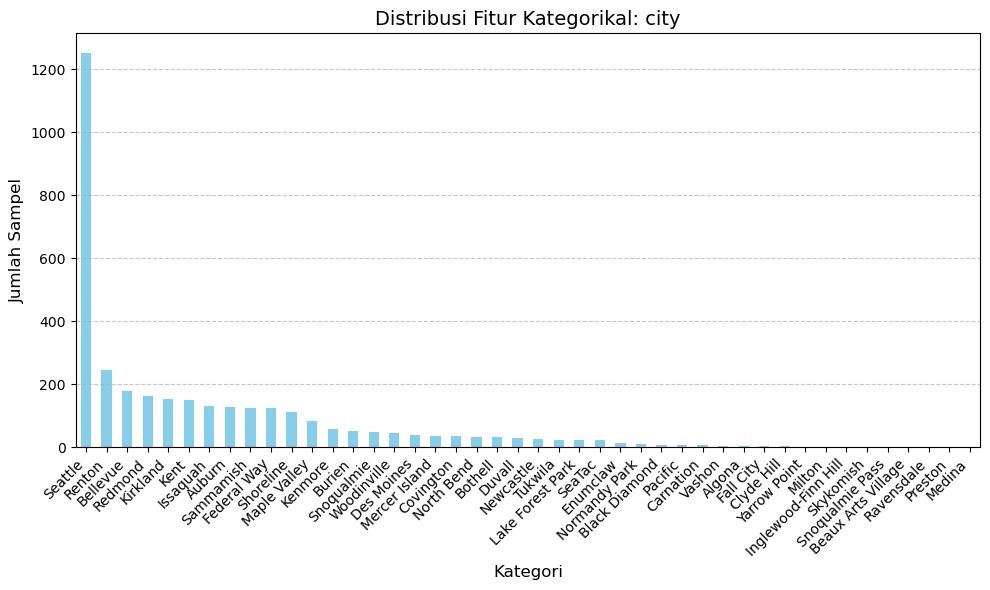

In [132]:
plot_categorical_feature(df_house, 'city')

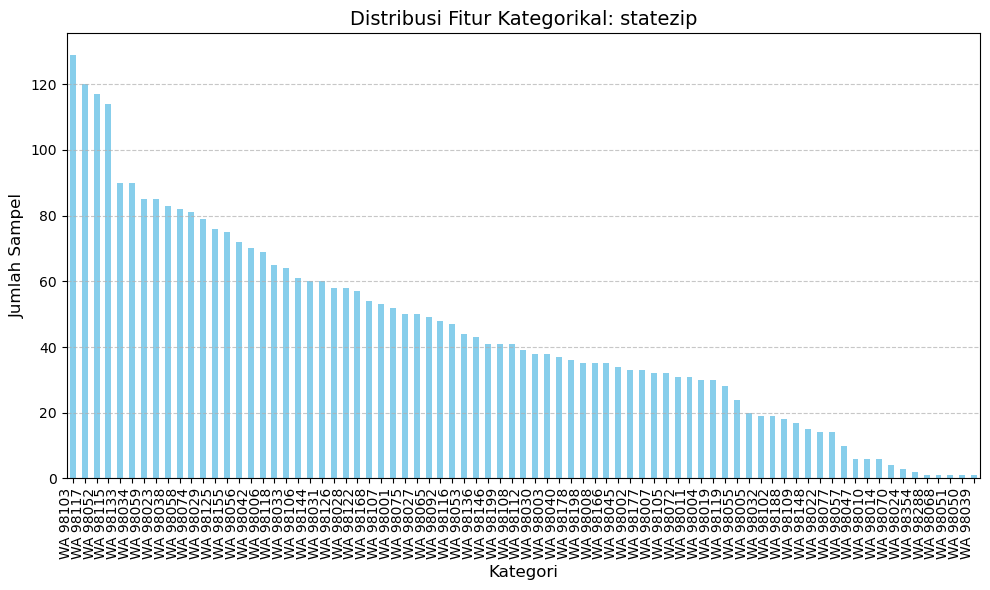

In [133]:
plot_categorical_feature(df_house, 'statezip', 90)

#### Melihat distribusi data

- Membuat histogram untuk semua kolom numerik dalam dataset.
- Histogram menunjukkan distribusi data untuk masing-masing kolom.

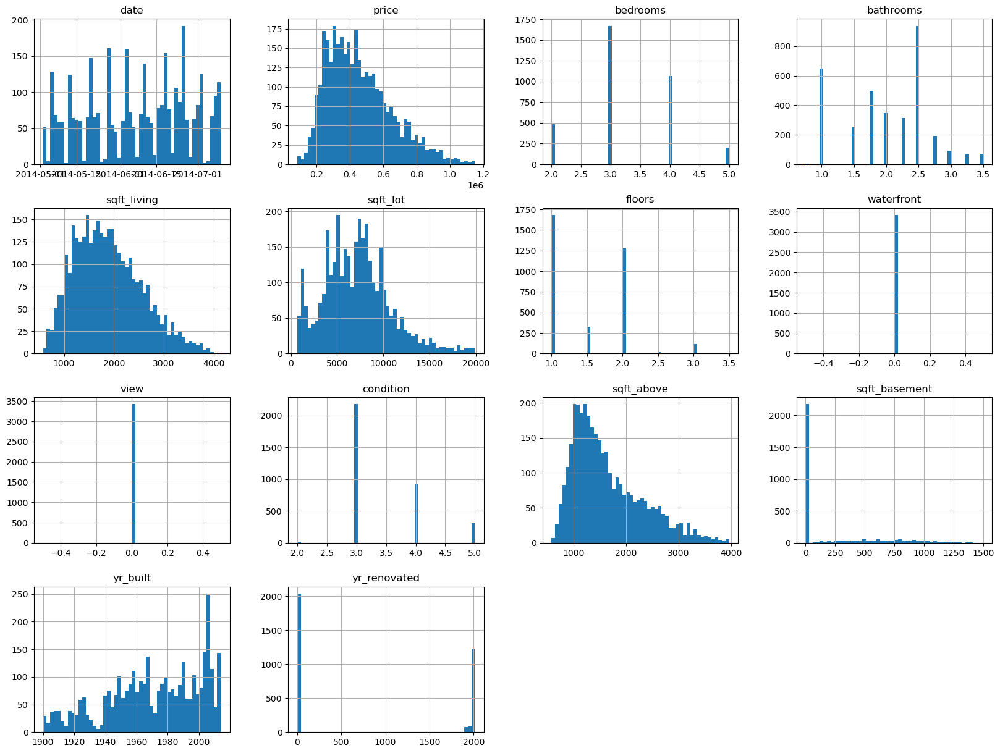

In [134]:
df_house.hist(bins=50, figsize=(20,15))
plt.show()

In [135]:
categorical_features_selected = ['statezip', 'city']

#### Melihat Visualisasi data

- Membuat bar chart menggunakan `seaborn.catplot` untuk menunjukkan rata-rata `price` terhadap kolom `statezip` dan `city`.
- Label sumbu-x diputar 90 derajat untuk keterbacaan lebih baik.

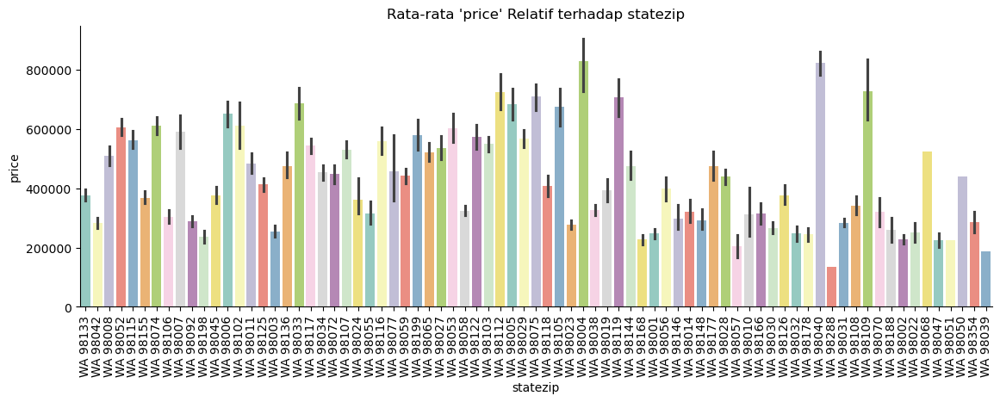

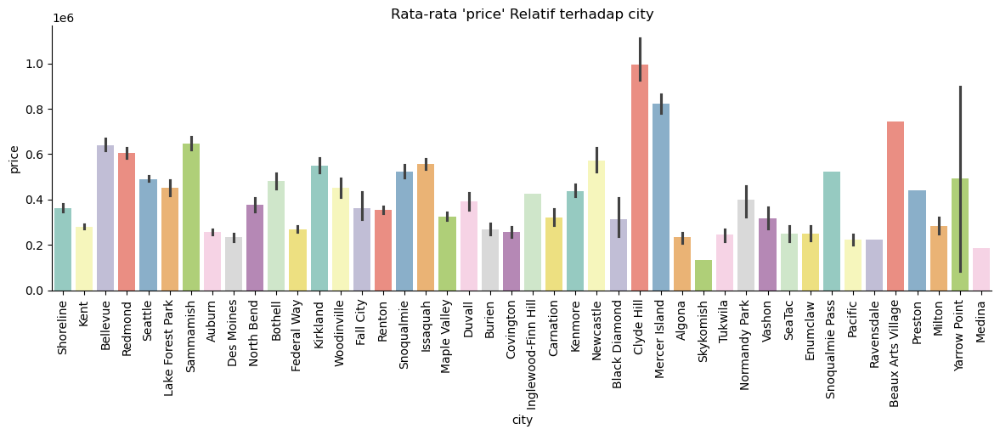

In [136]:
# Perulangan untuk membuat plot
for col in categorical_features_selected:
    sns.catplot(
        x=col, y="price", kind="bar", 
        dodge=False, height=4, aspect=3, 
        data=df_house, hue=col, palette="Set3"
    )
    plt.title(f"Rata-rata 'price' Relatif terhadap {col}")
    plt.xticks(rotation=90)

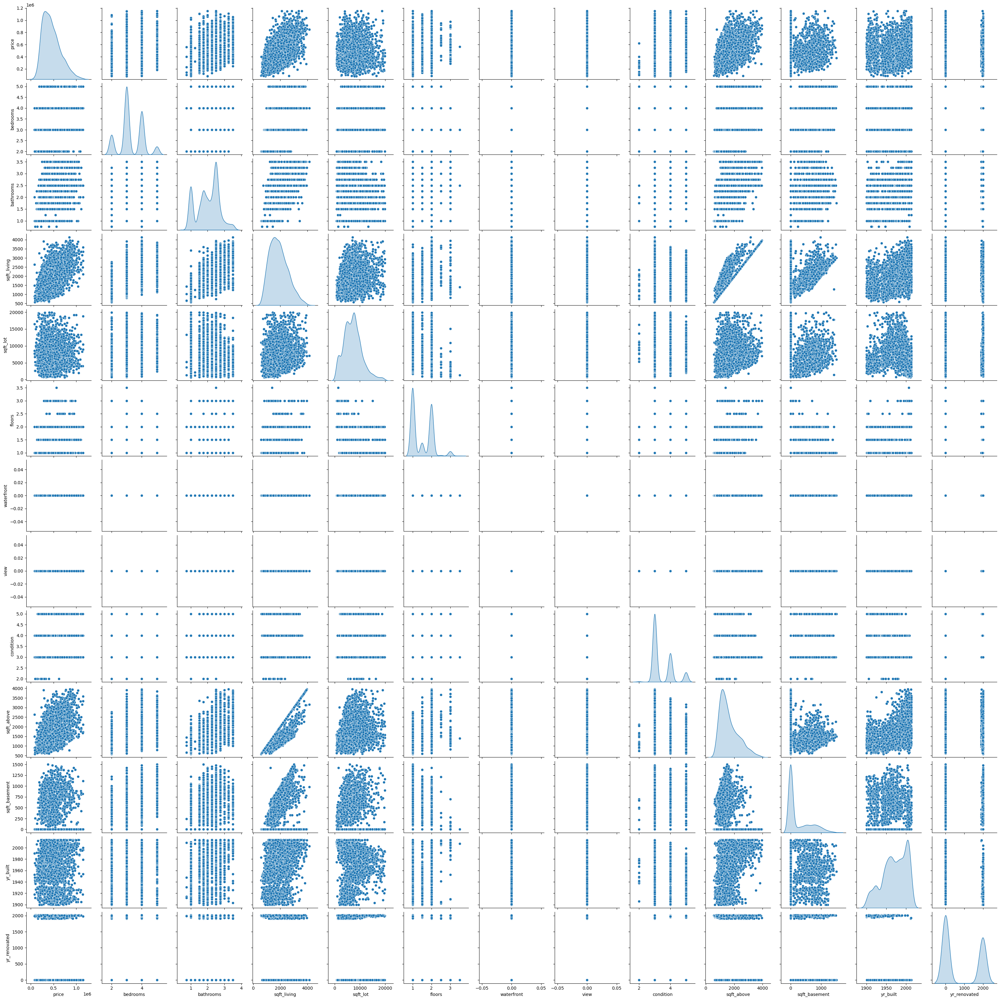

In [137]:
sns.pairplot(df_house, diag_kind = 'kde')

#### Korelasi antar fitur numerik

- Membuat heatmap korelasi untuk kolom numerik dalam dataset.
- Heatmap menunjukkan hubungan linier antara fitur-fitur numerik.

Text(0.5, 1.0, 'Correlation Matrix untuk Fitur Numerik ')

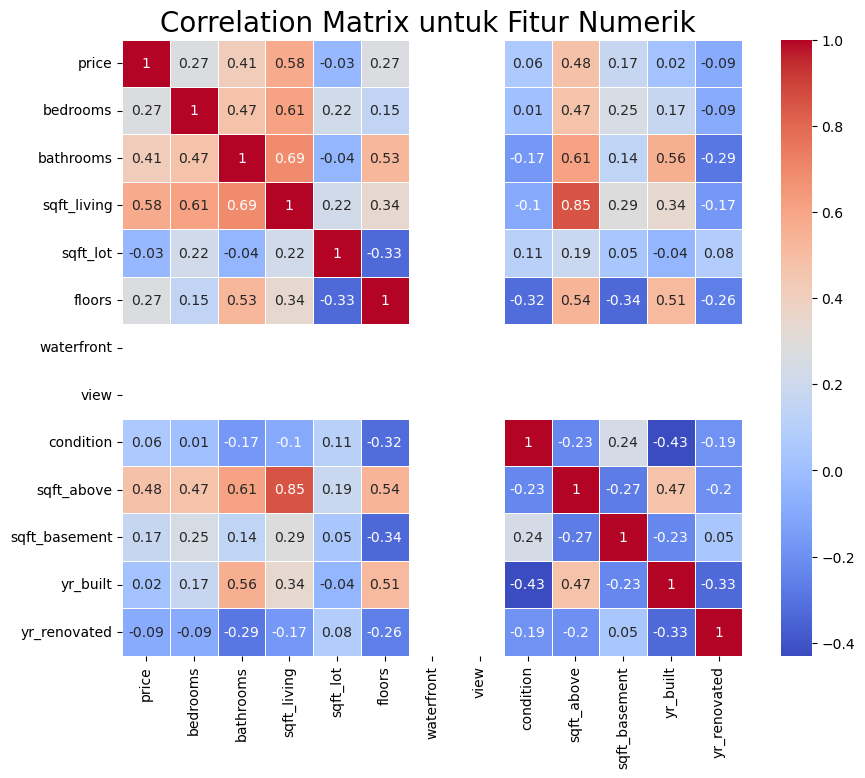

In [138]:
plt.figure(figsize=(10, 8))
correlation_matrix = df_house[numerical_features].corr().round(2)
 

sns.heatmap(data=correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, )
plt.title("Correlation Matrix untuk Fitur Numerik ", size=20)

#### One-Hot Encoding

- Mengonversi kolom kategorikal menjadi representasi numerik menggunakan metode one-hot encoding.
- Menggunakan `drop_first=True` untuk menghindari multikolinearitas dengan membuang salah satu kategori.

In [141]:

df_house=pd.get_dummies(df_house,drop_first=True)

#### Menampilkan beberapa fitur yang memiliki sedikit korelasi  

- Membuat pair plot untuk beberapa fitur numerik untuk mengeksplorasi hubungan antar fitur.
- Ukuran marker diatur kecil untuk mempermudah interpretasi data jika ada banyak titik.

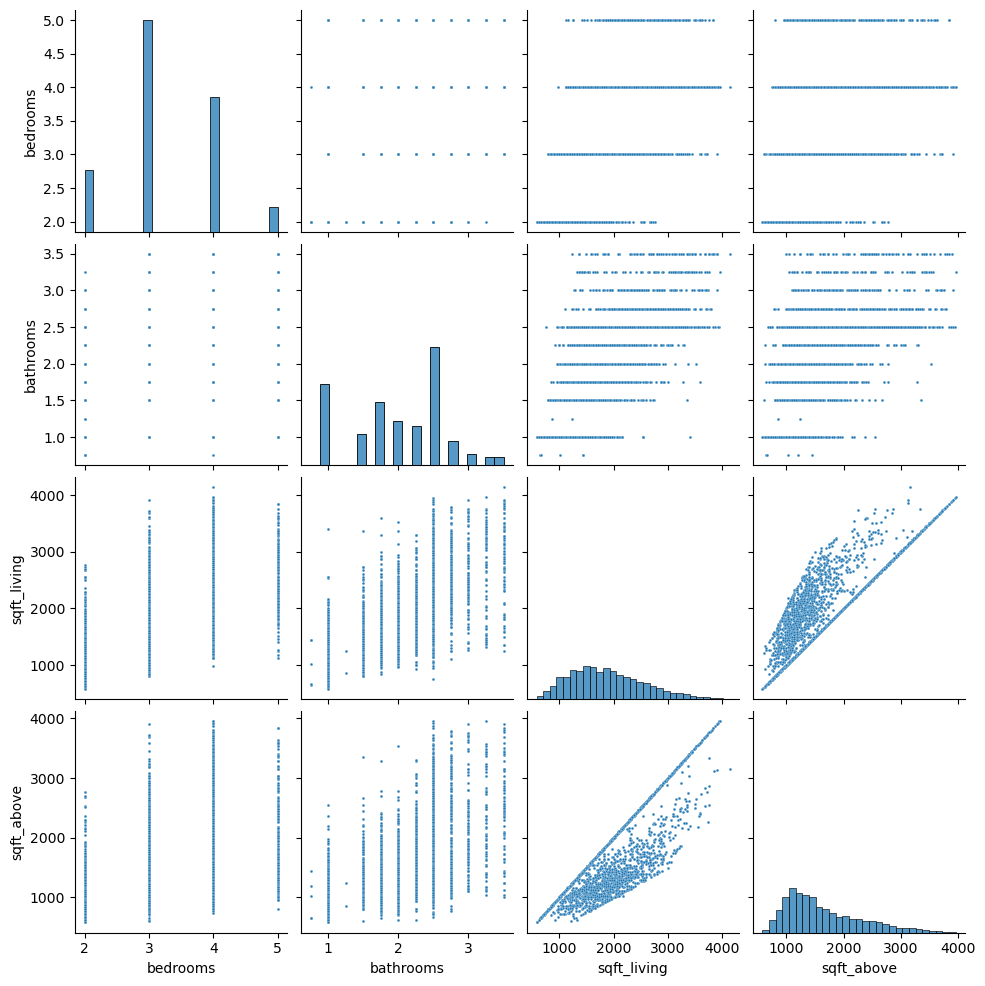

In [142]:
sns.pairplot(df_house[['bedrooms','bathrooms','sqft_living', 'sqft_above']], plot_kws={"s": 4});

#### Mengatur split data 

- Membagi dataset menjadi data pelatihan dan data uji. 
- Fitur `price` dan `date` dihapus dari fitur input (`X`).


In [143]:
X = df_house.drop(["price", "date"],axis =1)
y = df_house["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

In [144]:
print(f'Total # of sample in whole dataset: {len(X)}')
print(f'Total # of sample in train dataset: {len(X_train)}')
print(f'Total # of sample in test dataset: {len(X_test)}')

Total # of sample in whole dataset: 3422
Total # of sample in train dataset: 2737
Total # of sample in test dataset: 685


#### Menyimpan model-model dalam Data Frame

Membuat DataFrame untuk menyimpan nilai Mean Squared Error (MSE) dari berbagai model regresi.

In [145]:
models = pd.DataFrame(index=['train_mse', 'test_mse'], 
                      columns=['KNN', 'RandomForest', 'Boosting', 'LinearRegression'])

#### Melatih beberapa model

- Melatih model K-Nearest Neighbors dan menyimpan nilai MSE data pelatihan ke DataFrame `models`.
- Melatih model Random Forest dan menyimpan nilai MSE data pelatihan ke DataFrame `models`.
- Melatih model AdaBoost Regressor dan menyimpan nilai MSE data pelatihan ke DataFrame `models`.
- Melatih model Linear Regression dan menyimpan nilai MSE data pelatihan ke DataFrame `models`. 

In [147]:
knn = KNeighborsRegressor(n_neighbors=19)
knn.fit(X_train, y_train)
 
models.loc['train_mse','knn'] = mean_squared_error(y_pred = knn.predict(X_train), y_true=y_train)

In [148]:
param_grid = {'n_estimators': [50, 100, 150, 200, 300]}

rf = RandomForestRegressor(max_depth=16, random_state=55, n_jobs=-1)

grid = GridSearchCV(estimator=rf, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)
grid.fit(X_train, y_train)

print("Optimal n_estimators:", grid.best_params_['n_estimators'])
print("Best CV MSE:", -grid.best_score_)

Optimal n_estimators: 300
Best CV MSE: 10227931011.696575


In [149]:
RF = RandomForestRegressor(n_estimators=200, max_depth=16, random_state=55, n_jobs=-1)
RF.fit(X_train, y_train)
 
models.loc['train_mse','RandomForest'] = mean_squared_error(y_pred=RF.predict(X_train), y_true=y_train)   

In [150]:
boosting = AdaBoostRegressor(learning_rate=0.05, random_state=55)                             
boosting.fit(X_train, y_train)
models.loc['train_mse','Boosting'] = mean_squared_error(y_pred=boosting.predict(X_train), y_true=y_train)

In [151]:
lr=LinearRegression()
lr.fit(X_train, y_train)
models.loc['train_mse','LinearRegression'] = mean_squared_error(y_pred=lr.predict(X_train), y_true=y_train)

#### Data Normalization

- Normalisasi data pada fitur numerik menggunakan `StandardScaler` dari `sklearn`. 
- Skala data dilatih berdasarkan data training, lalu diterapkan pada data test untuk memastikan distribusi data seragam antara training dan testing.


In [152]:
scaler = StandardScaler()
scaler.fit(X_train)

StandardScaler()

In [154]:
numerical_features = [feature for feature in numerical_features if feature != 'price']
X_test.loc[:, numerical_features] = scaler.transform(X_test[numerical_features])

/tmp/ipykernel_7966/3198593224.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[-0.88079395  1.19301307 -0.44499392 -1.30156638  1.23809583  0.56185441
  0.06594404  0.33644061 -0.92587671 -1.57206295 -1.33162156  0.90748892
 -1.45184226 -1.21140086  0.62196476 -0.7004629   0.18616474  1.70395103
  1.91433725 -0.4750491  -1.22642845  1.01268202  0.18616474 -0.24963529
  1.11787513 -0.83571119 -0.29471805 -0.29471805  1.20804066  0.03588886
  0.21621991 -0.97095947  1.01268202 -0.97095947  0.08097163 -0.62532497
 -0.14444218 -1.03106982 -0.52013186 -0.39991116 -0.85073877  0.17113715
 -0.74554566 -0.56521462 -0.30974564 -1.45184226  0.63699235 -0.36985599
  0.20119232  0.99765444  0.44163372  0.32141302 -0.61029738 -0.79062842
  0.576882   -0.05427666  0.93754409 -0.26466288  0.24627508 -0.89582153
 -0.8206836  -0.76057325 -0.06930424  0.53179924  0.02086128 -0.14444218
  2.59057867 -0.74554566  1.20804066 -1.39

#### Model Evaluation Menggunakan Mean Squared Error (MSE)

Cell ini mengevaluasi performa setiap model menggunakan metrik Mean Squared Error (MSE) pada data training dan testing. Hasil MSE disimpan dalam DataFrame `mse` untuk analisis lebih lanjut. Hasil dibagi dalam ribuan untuk kemudahan interpretasi.


In [155]:
mse = pd.DataFrame(columns=['train', 'test'], index=['KNN','RF','Boosting', 'LR'])
 
model_dict = {'KNN': knn, 'RF': RF, 'Boosting': boosting, 'LR': lr}
 
for name, model in model_dict.items():
    mse.loc[name, 'train'] = mean_squared_error(y_true=y_train, y_pred=model.predict(X_train))/1e3 
    mse.loc[name, 'test'] = mean_squared_error(y_true=y_test, y_pred=model.predict(X_test))/1e3
 
mse

,train,test
KNN,21262995.144448,48553166.185254
RF,2636168.939598,74487690.747625
Boosting,20632960.616099,47761339.131888
LR,18103.620197,7799739810.355667


#### Visualisasi performa model

Visualisasi performa model menggunakan bar chart horizontal. MSE untuk data testing diurutkan dari nilai tertinggi ke terendah untuk memberikan gambaran jelas model mana yang memiliki error terendah pada data testing.


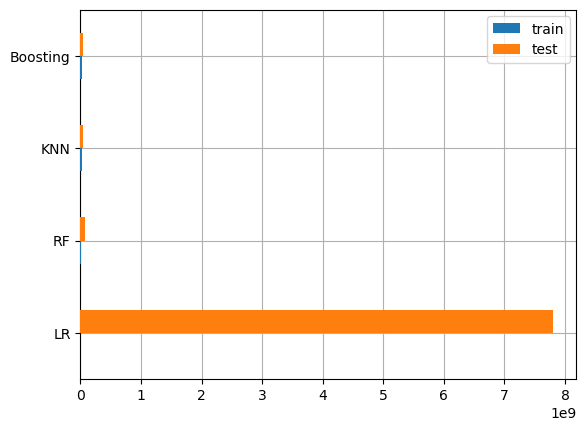

In [156]:
fig, ax = plt.subplots()
mse.sort_values(by='test', ascending=False).plot(kind='barh', ax=ax, zorder=3)
ax.grid(zorder=0)

#### Prediksi dengan data random

Prediksi pada satu sampel data dari dataset test menggunakan semua model yang telah dilatih. Hasil prediksi dari setiap model dibandingkan dengan nilai aktual (y_true). Output disajikan dalam bentuk DataFrame untuk kemudahan interpretasi.


In [157]:
prediksi = X_test.iloc[:1].copy()
pred_dict = {'y_true':y_test[:1]}
for name, model in model_dict.items():
    pred_dict['prediksi_'+name] = model.predict(prediksi).round(1)
 
pd.DataFrame(pred_dict)

,y_true,prediksi_KNN,prediksi_RF,prediksi_Boosting,prediksi_LR
510,265000.0,365870.8,279893.4,325654.7,4044357.8
